In [ ]:
import os
import torch
from tqdm.auto import tqdm
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
from efficientnet_pytorch import EfficientNet
from PIL import Image
from torch import optim, nn
from sklearn.metrics import recall_score, f1_score, roc_auc_score, roc_curve

# 데이터 전처리 설정
transform = transforms.Compose([
    transforms.Resize(256),
    # transforms.Resize(600),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

In [ ]:
# #이미지 증강
# transform_with_augmentation = transforms.Compose([
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomRotation(15),  # 예: 15도 내에서 무작위로 회전
#     transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
#     transforms.Resize(256),
#     transforms.CenterCrop(224),
#     transforms.ToTensor(),
#     transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
# ])

In [ ]:
transform_with_augmentation = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),  # 예: 15도 내에서 무작위로 회전
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    transforms.RandomPerspective(distortion_scale=0.5, p=0.5),  # 무작위 투시 변환 추가
    transforms.GaussianBlur(3, sigma=(0.1, 2.0)),  # 가우시안 블러 추가
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

In [ ]:
cd /workspace/data/tomato/EfficientNet/

In [ ]:
# 사용자 정의 데이터셋 클래스
class CustomImageDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.classes = ['healthy', 'PowderyMildew', 'GrayMold', 'YellowLeafCurlVirus', 'EarlyBlight', 'LeafMold']
        self.img_paths = []
        valid_extensions = ('.jpg', '.jpeg', '.png', '.JPG','.JPEG','PNG')
        for dirpath, dirnames, filenames in os.walk(root_dir):
            for filename in filenames:
                if filename.lower().endswith(valid_extensions):
                    self.img_paths.append(os.path.join(dirpath, filename))

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img_path = self.img_paths[idx]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        label = self.get_label(img_path)
        return image, label

    def get_label(self, img_path):
        if '0_healthy' in img_path:
            return self.classes.index('healthy')
        elif '1_PowderyMildew' in img_path:
            return self.classes.index('PowderyMildew')
        elif '2_GrayMold' in img_path:
            return self.classes.index('GrayMold')
        elif '3_YellowLeafCurlVirus' in img_path:
            return self.classes.index('YellowLeafCurlVirus')        
        elif '4_LeafMold' in img_path:
            return self.classes.index('LeafMold')
        elif '5_EarlyBlight' in img_path:
            return self.classes.index('EarlyBlight')  

In [ ]:
# 학습 및 검증 데이터 로딩
train_dirs = ["./TrainingDataSet/0_healthy/",
                "./TrainingDataSet/1_PowderyMildew/",
                "./TrainingDataSet/2_GrayMold/",
                "./TrainingDataSet/3_YellowLeafCurlVirus/",
                "./TrainingDataSet/4_LeafMold/",
                "./TrainingDataSet/5_EarlyBlight/"
             ]
val_dirs = ["./ValidationDataSet/0_healthy/",
            "./ValidationDataSet/1_PowderyMildew/",
            "./ValidationDataSet/2_GrayMold/",
            "./ValidationDataSet/3_YellowLeafCurlVirus/",
            "./ValidationDataSet/4_LeafMold/",
            "./ValidationDataSet/5_EarlyBlight/",
           ]

train_datasets = [CustomImageDataset(train_dir, transform=transform_with_augmentation) for train_dir in train_dirs]
val_datasets = [CustomImageDataset(val_dir, transform=transform) for val_dir in val_dirs]

train_dataset = torch.utils.data.ConcatDataset(train_datasets)
val_dataset = torch.utils.data.ConcatDataset(val_datasets)

train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True, num_workers=12)
val_loader = DataLoader(val_dataset, batch_size=128, shuffle=False, num_workers=12)

In [ ]:
# # train데이터셋에 대한 질병별 이미지 수 확인
# label_counts = {class_name: 0 for class_name in train_dataset.datasets[0].classes}

# for image, label in train_dataset:
#     class_name = train_dataset.datasets[0].classes[label]
#     label_counts[class_name] += 1

# for disease, count in label_counts.items():
#     print(f"{disease}: {count}개")

In [ ]:
# # valid데이터셋에 대한 질병별 이미지 수 확인
# label_counts = {class_name: 0 for class_name in val_dataset.datasets[0].classes}

# for image, label in val_dataset:
#     class_name = val_dataset.datasets[0].classes[label]
#     label_counts[class_name] += 1

# for disease, count in label_counts.items():
#     print(f"{disease}: {count}개")

In [ ]:
# 모델 설정
model = EfficientNet.from_pretrained('efficientnet-b0', num_classes=6)  # num_classes를 조건에 맞게 6으로 설정

# GPU 사용 설정
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# optimizer 및 loss 함수 설정
#optimizer = optim.Adam(model.parameters(), lr=0.001)
optimizer = optim.Adam(model.parameters(), lr=0.0001)
criterion = nn.CrossEntropyLoss()

# 최고의 validation accuracy,recall 저장
best_acc = 0.0
best_recall = 0.0

In [ ]:
print(device)

In [ ]:
# 학습 및 검증 과정
num_epochs = 100  # 원하는 에포크 수로 설정
for epoch in range(num_epochs):
    model.train()  # 모델을 학습 모드로 설정
    for images, labels in tqdm(train_loader):
        images = images.to(device)
        labels = labels.to(device)
        
        optimizer.zero_grad()  # gradient 초기화
        outputs = model(images)  # forward propagation
        loss = criterion(outputs, labels)  # loss 계산
        loss.backward()  # backpropagation
        optimizer.step()  # weight 업데이트
        
    model.eval()  # 모델을 평가 모드로 설정
    all_labels = []
    all_predictions = []
    with torch.no_grad():  # gradient 계산 비활성화 (메모리 효율성을 위해)
        for images, labels in tqdm(val_loader):
            images = images.to(device)
            labels = labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            all_labels.extend(labels.cpu().numpy())
            all_predictions.extend(predicted.cpu().numpy())

    current_recall = recall_score(all_labels, all_predictions, average='macro')  # 'macro'는 모든 클래스의 재현율을 평균낸 값을 반환
    print(f'Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}, Validation Recall: {current_recall * 100}%')
    
    # 재현율이 현재까지 최고라면 모델 저장
    if current_recall > best_recall:
        torch.save(model.state_dict(), 'best_model_recall_1.pth')
        best_recall = current_recall
        print("model save")

In [ ]:
# # 학습 및 검증 과정 정확도
# num_epochs = 10  # 원하는 에포크 수로 설정
# for epoch in range(num_epochs):
#     model.train()  # 모델을 학습 모드로 설정
#     for images, labels in train_loader:
#         images = images.to(device)
#         labels = labels.to(device)
        
#         optimizer.zero_grad()  # gradient 초기화
#         outputs = model(images)  # forward propagation
#         loss = criterion(outputs, labels)  # loss 계산
#         loss.backward()  # backpropagation
#         optimizer.step()  # weight 업데이트
        
#     model.eval()  # 모델을 평가 모드로 설정
#     correct = 0
#     total = 0
#     with torch.no_grad():  # gradient 계산 비활성화 (메모리 효율성을 위해)
#         for images, labels in val_loader:
#             images = images.to(device)
#             labels = labels.to(device)
#             outputs = model(images)
#             _, predicted = torch.max(outputs.data, 1)
#             total += labels.size(0)
#             correct += (predicted == labels).sum().item()

#     val_acc = correct / total
#     print(f'Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}, Validation Accuracy: {val_acc * 100}%')
    
#     # 검증 정확도가 현재까지 최고라면 모델 저장
#     if val_acc > best_acc:
#         torch.save(model.state_dict(), 'best_model.pth')
#         best_acc = val_acc

In [ ]:
best_acc

# 테스트 진행

In [1]:
cd /workspace/data/tomato/EfficientNet/TestDataSet/total

/workspace/data/tomato/EfficientNet/TestDataSet/total


In [2]:
import os
import torch
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
from efficientnet_pytorch import EfficientNet
from PIL import Image
from torch import optim, nn
from sklearn.metrics import recall_score, f1_score, roc_auc_score, roc_curve

# 데이터 전처리 설정
transform = transforms.Compose([
    transforms.Resize(256),
    # transforms.Resize(600),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

In [3]:
# 사용자 정의 데이터셋 클래스
class CustomImageDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.classes = ['healthy', 'PowderyMildew', 'GrayMold', 'YellowLeafCurlVirus', 'EarlyBlight', 'LeafMold']
        self.img_paths = []
        valid_extensions = ('.jpg', '.jpeg', '.png', '.JPG','.JPEG','PNG')
        for dirpath, dirnames, filenames in os.walk(root_dir):
            for filename in filenames:
                if filename.lower().endswith(valid_extensions):
                    self.img_paths.append(os.path.join(dirpath, filename))

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img_path = self.img_paths[idx]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        label = self.get_label(img_path)
        return image, label, img_path  # img_path를 추가

    def get_label(self, img_path):
        if '0_healthy' in img_path:
            return self.classes.index('healthy')
        elif '1_PowderyMildew' in img_path:
            return self.classes.index('PowderyMildew')
        elif '2_GrayMold' in img_path:
            return self.classes.index('GrayMold')
        elif '3_YellowLeafCurlVirus' in img_path:
            return self.classes.index('YellowLeafCurlVirus')        
        elif '4_LeafMold' in img_path:
            return self.classes.index('LeafMold')
        elif '5_EarlyBlight' in img_path:
            return self.classes.index('EarlyBlight')  

In [4]:
# # 사용자 정의 데이터셋 클래스
# class CustomImageDataset(Dataset):
#     def __init__(self, root_dir, transform=None):
#         self.root_dir = root_dir
#         self.transform = transform
#         self.classes = ['healthy', 'PowderyMildew', 'GrayMold', 'YellowLeafCurlVirus', 'EarlyBlight', 'LeafMold']
#         self.img_paths = []
#         valid_extensions = ('.jpg', '.jpeg', '.png', '.JPG','.JPEG','PNG')
#         for dirpath, dirnames, filenames in os.walk(root_dir):
#             for filename in filenames:
#                 if filename.lower().endswith(valid_extensions):
#                     self.img_paths.append(os.path.join(dirpath, filename))

#     def __len__(self):
#         return len(self.img_paths)

#     def __getitem__(self, idx):
#         img_path = self.img_paths[idx]
#         image = Image.open(img_path).convert('RGB')
#         if self.transform:
#             image = self.transform(image)
#         label = self.get_label(img_path)
#         return image, label

#     def get_label(self, img_path):
#         if '0_healthy' in img_path:
#             return self.classes.index('healthy')
#         elif '1_PowderyMildew' in img_path:
#             return self.classes.index('PowderyMildew')
#         elif '2_GrayMold' in img_path:
#             return self.classes.index('GrayMold')
#         elif '3_YellowLeafCurlVirus' in img_path:
#             return self.classes.index('YellowLeafCurlVirus')        
#         elif '4_LeafMold' in img_path:
#             return self.classes.index('LeafMold')
#         elif '5_EarlyBlight' in img_path:
#             return self.classes.index('EarlyBlight')  

In [5]:
# 테스트 데이터 
test_dirs = ["./0_healthy/",
            "./1_PowderyMildew/",
            "./2_GrayMold/",
            "./3_YellowLeafCurlVirus/",
            "./4_LeafMold/",
            "./5_EarlyBlight/",
           ]

test_datasets = [CustomImageDataset(test_dir, transform=transform) for test_dir in test_dirs]
test_dataset = torch.utils.data.ConcatDataset(test_datasets)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

In [6]:
# 최적의 모델 불러오기
model = EfficientNet.from_name('efficientnet-b0')

# GPU 사용 설정
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# 분류할 클래스 수 변경
num_classes = 6
model._fc = torch.nn.Linear(model._fc.in_features, num_classes)

In [7]:
# # test 데이터셋에 대한 질병별 이미지 수 확인
# label_counts = {class_name: 0 for class_name in test_dataset.datasets[0].classes}

# for image, label in test_dataset:
#     class_name = test_dataset.datasets[0].classes[label]
#     label_counts[class_name] += 1

# for disease, count in label_counts.items():
#     print(f"{disease}: {count}개")

In [10]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict
from sklearn.metrics import recall_score, f1_score, roc_auc_score, roc_curve

# 체크포인트 로드
model.load_state_dict(torch.load('/workspace/data/tomato/EfficientNet/best_model_recall_1.pth'))
model = model.to(device)

# 모델을 평가 모드로 설정
model.eval()

# 테스트 데이터셋 평가
correct = 0
total = 0

class_correct = defaultdict(int)  # 클래스별로 올바르게 분류된 수를 저장
class_total = defaultdict(int)    # 각 클래스별 전체 샘플 수를 저장

all_labels = []
all_predicted = []
all_outputs = []

wrong_labels = []
wrong_predictions = []
wrong_images = []
wrong_image_paths = []

with torch.no_grad():  # gradient 계산 비활성화
    for images, labels, paths in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)

        #재현율, F1, ROC커브
        all_labels.extend(labels.cpu().numpy())
        all_predicted.extend(predicted.cpu().numpy())
        all_outputs.extend(outputs.cpu().numpy())
        
        # 정확도 계산
        c = (predicted == labels).squeeze()
        for i, label in enumerate(labels):
            class_correct[label.item()] += c[i].item()
            class_total[label.item()] += 1
        
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        wrong_indices = (predicted != labels).nonzero(as_tuple=True)
        if wrong_indices[0].shape[0] > 0:  # 잘못 예측된 것이 하나 이상 있다면
            wrong_labels.extend(labels[wrong_indices].cpu().numpy())
            wrong_predictions.extend(predicted[wrong_indices].cpu().numpy())
            wrong_images.extend(images[wrong_indices].cpu().numpy())
            wrong_image_paths.extend(np.array(paths)[wrong_indices[0].cpu()])  # 이미지 경로 추가

test_acc = correct / total
print(f'테스트 정확도: {test_acc * 100:.2f}%')

# 재현율, F1 스코어 계산
recall = recall_score(all_labels, all_predicted, average='macro')
f1 = f1_score(all_labels, all_predicted, average='macro')
print(f'재현율: {recall:.2f}')
print(f'F1 스코어: {f1:.2f}')

테스트 정확도: 95.71%
재현율: 0.92
F1 스코어: 0.94


In [11]:
# 클래스별 정확도 출력
for i in range(len(test_dataset.datasets[0].classes)):
    class_name = test_dataset.datasets[0].classes[i]
    accuracy = 100 * class_correct[i] / class_total[i]
    print(f'정확도 of {class_name}: {accuracy:.2f}%')

정확도 of healthy: 99.84%
정확도 of PowderyMildew: 93.02%
정확도 of GrayMold: 98.17%
정확도 of YellowLeafCurlVirus: 88.02%
정확도 of EarlyBlight: 100.00%
정확도 of LeafMold: 73.27%


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: EarlyBlight


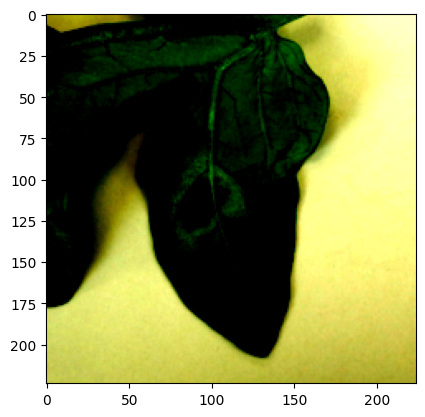

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


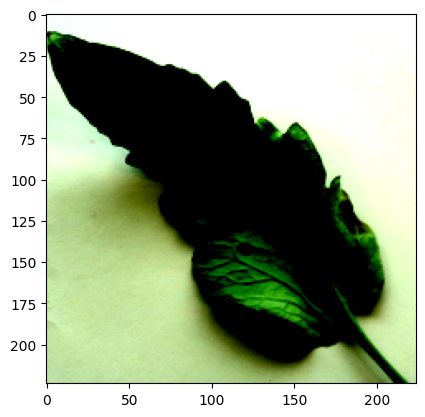

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: EarlyBlight


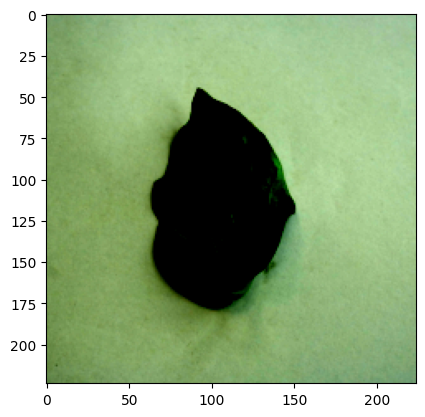

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


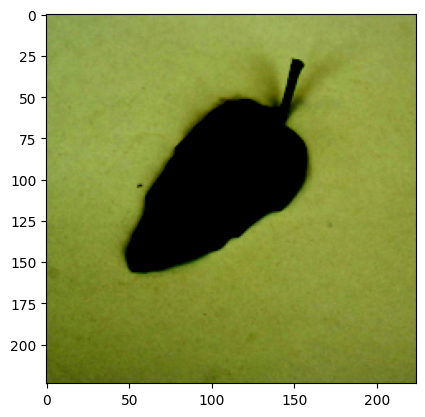

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


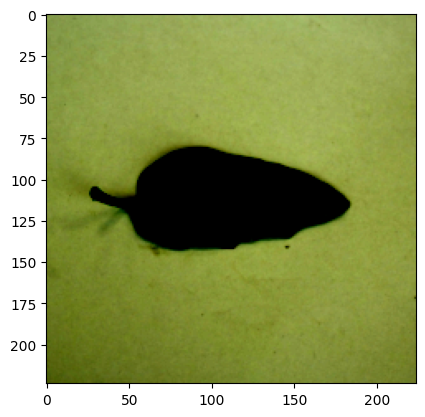

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


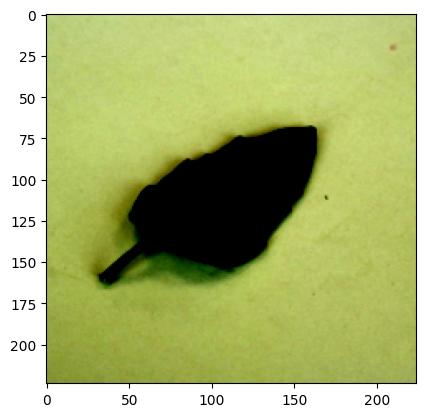

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: healthy


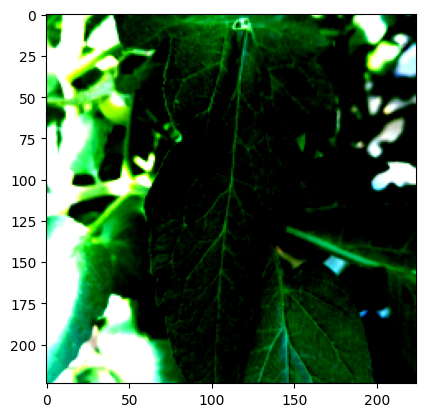

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


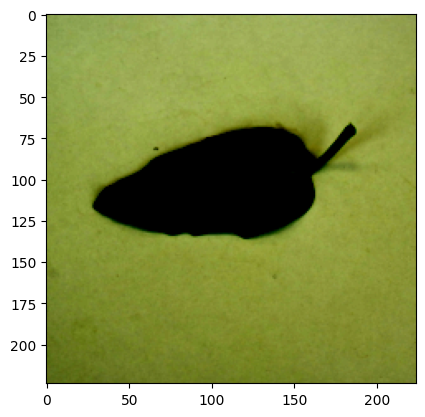

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


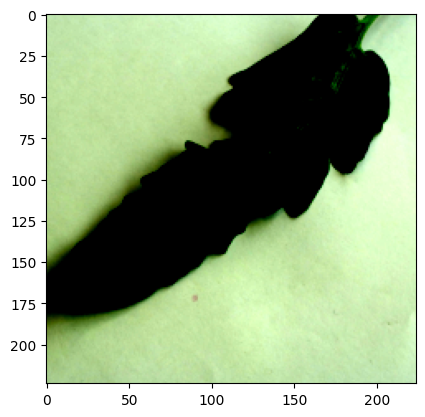

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: healthy


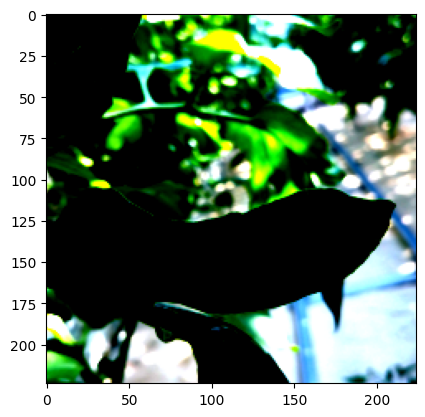

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


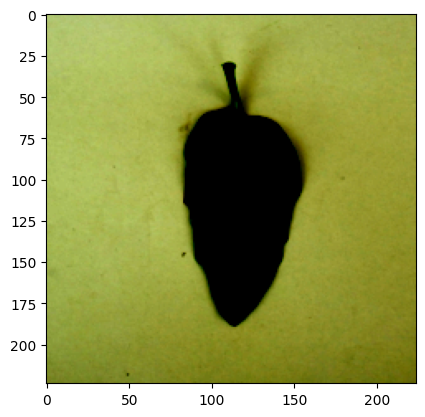

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


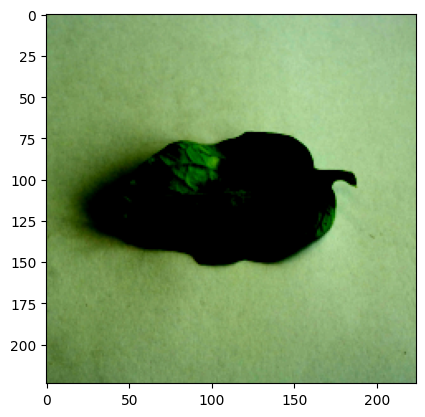

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


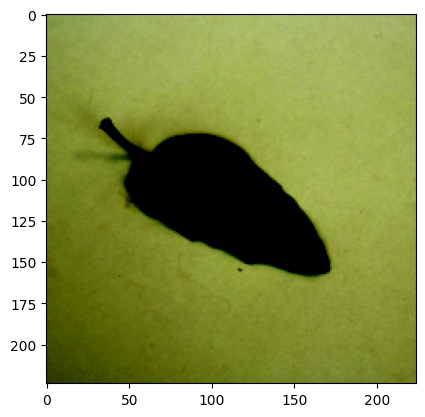

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


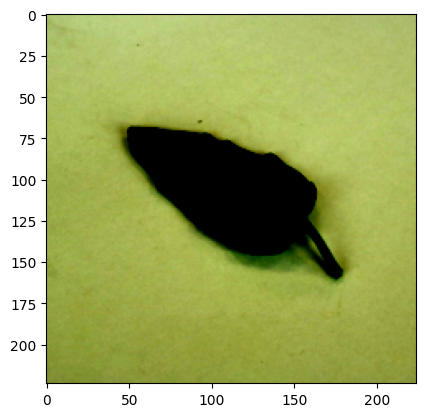

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


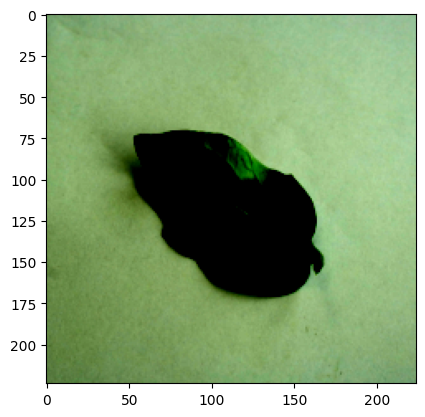

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


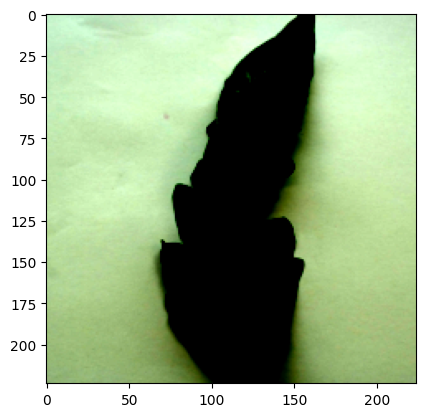

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


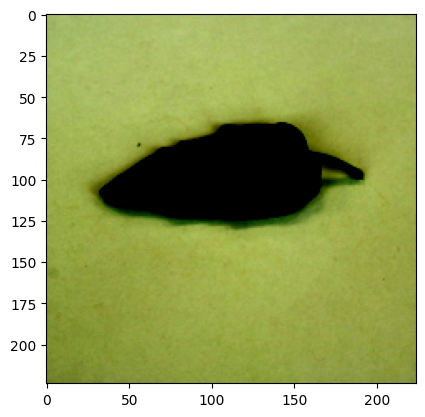

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


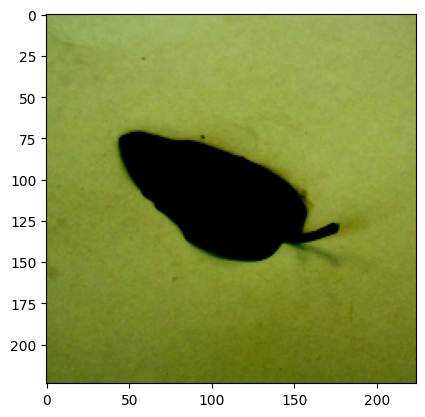

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


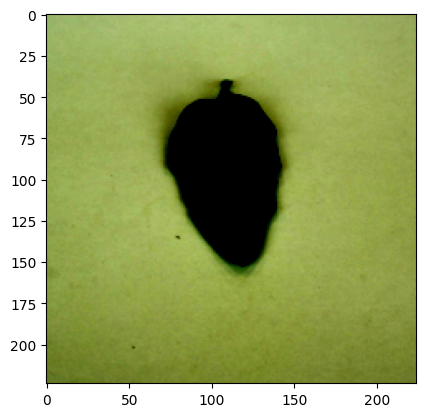

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


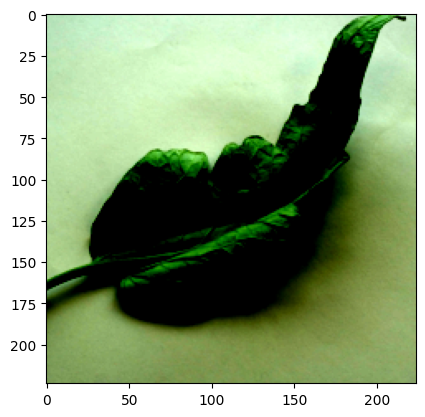

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: EarlyBlight


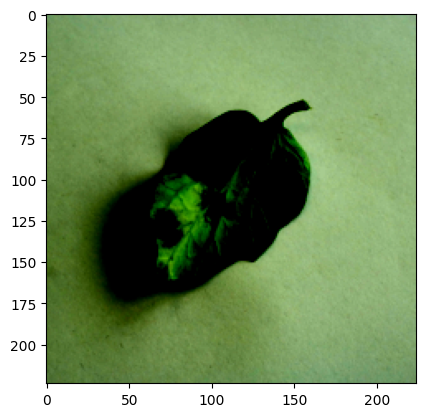

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


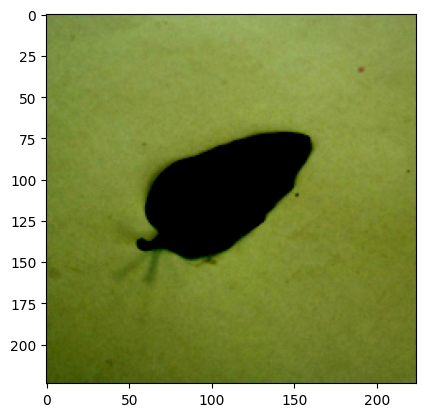

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: healthy


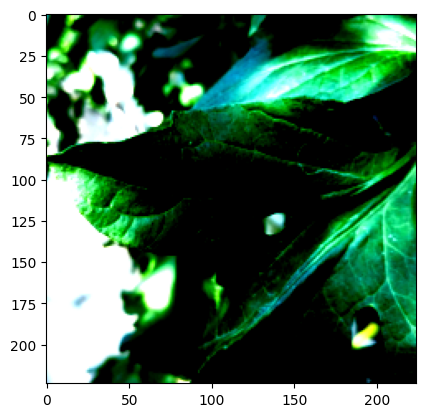

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: healthy


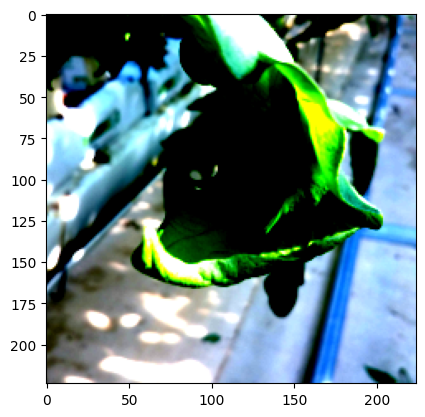

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


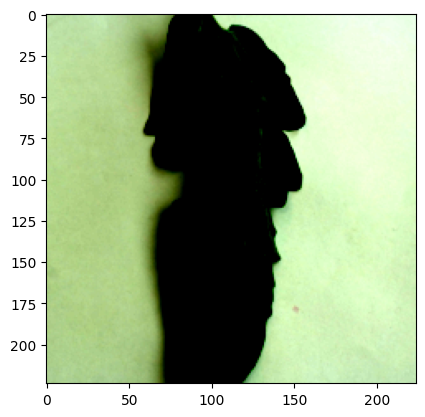

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


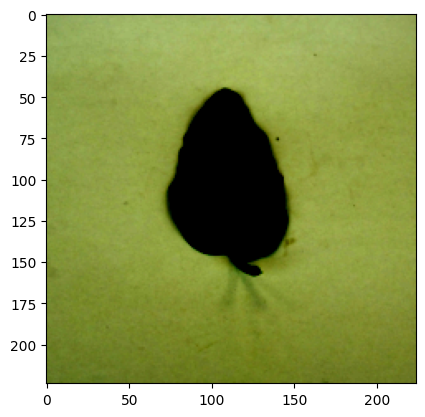

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


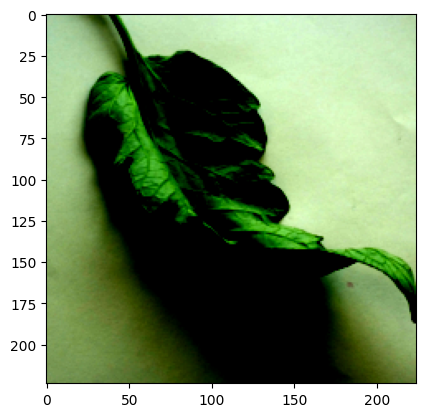

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


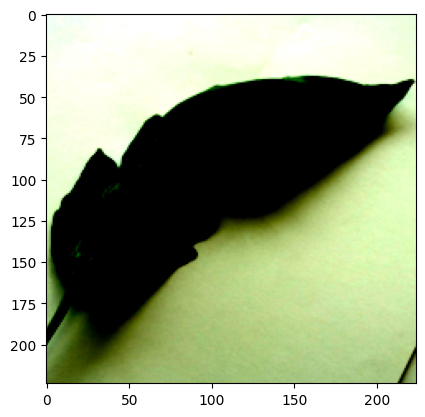

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: healthy


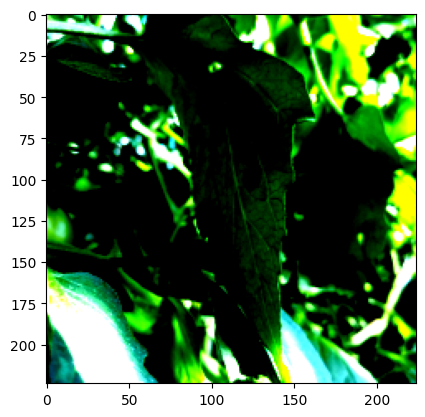

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


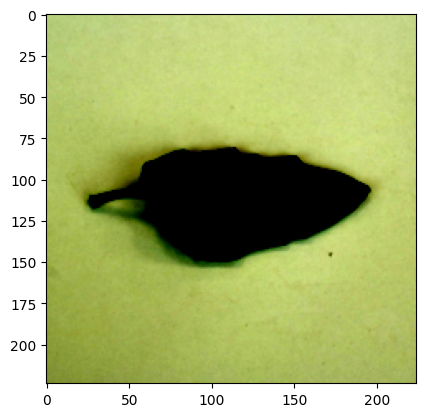

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


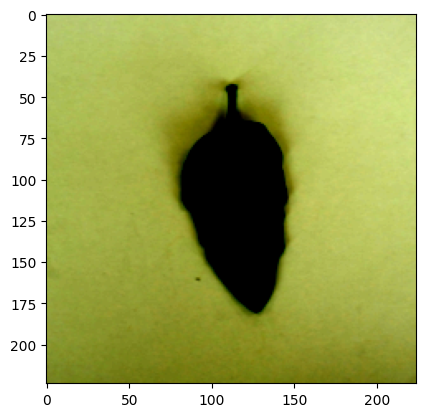

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


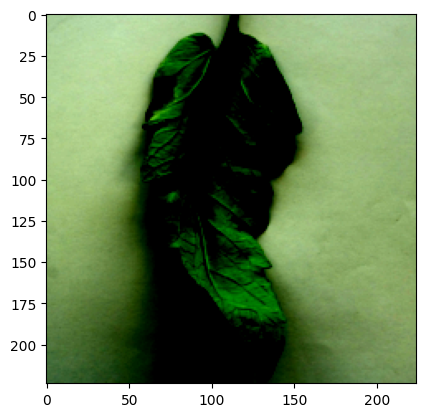

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


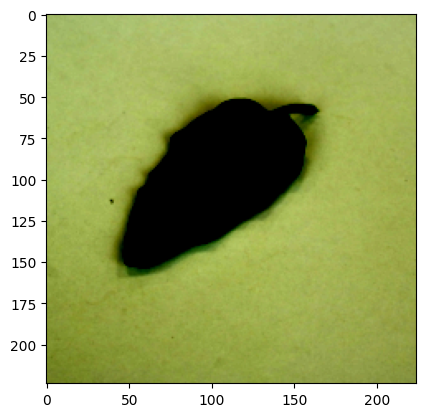

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


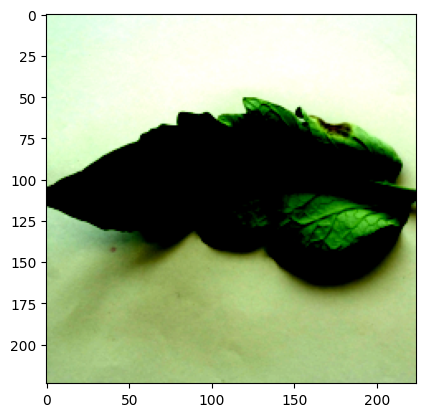

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


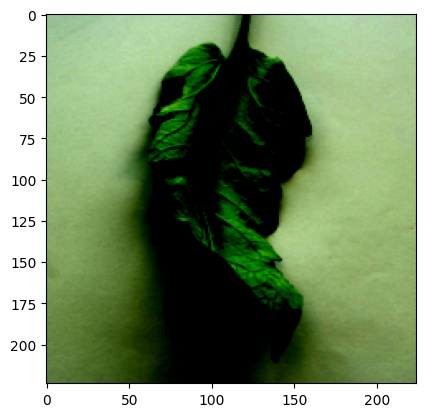

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


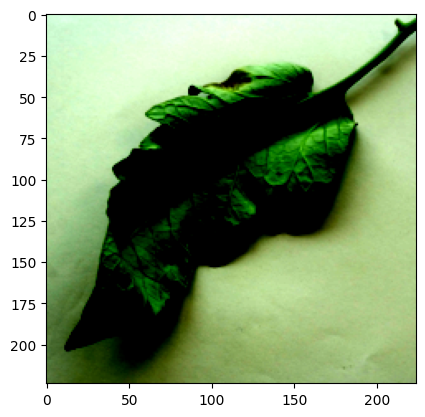

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: healthy


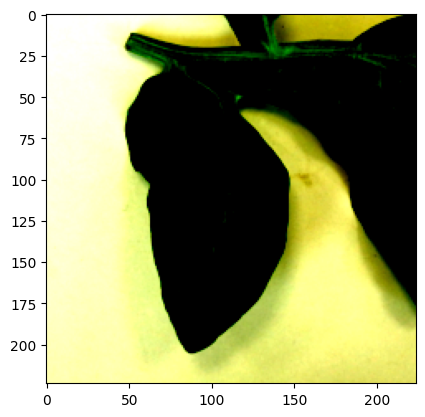

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


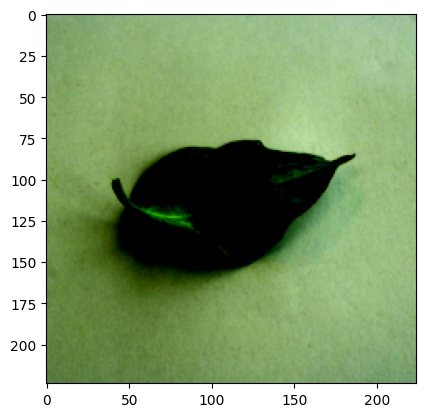

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


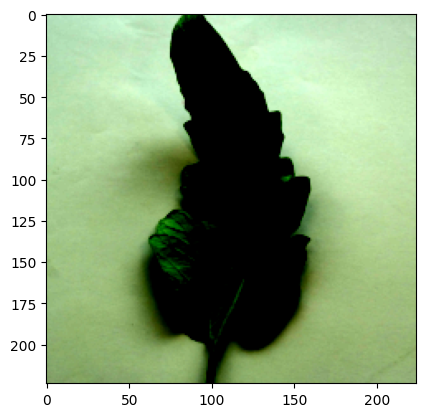

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: healthy


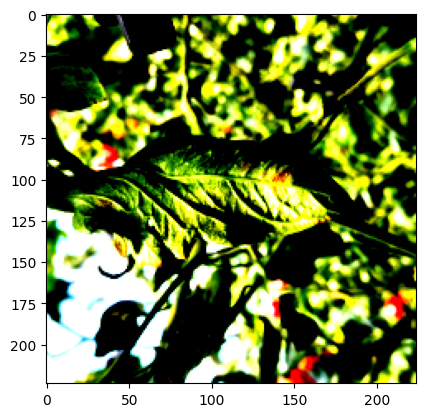

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


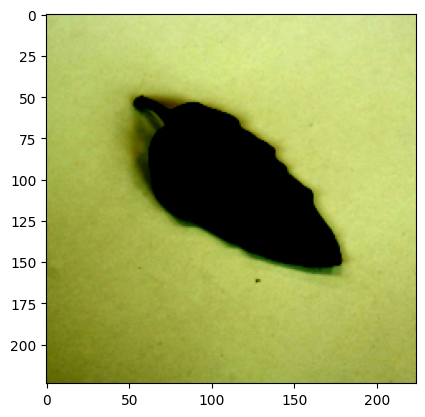

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: healthy


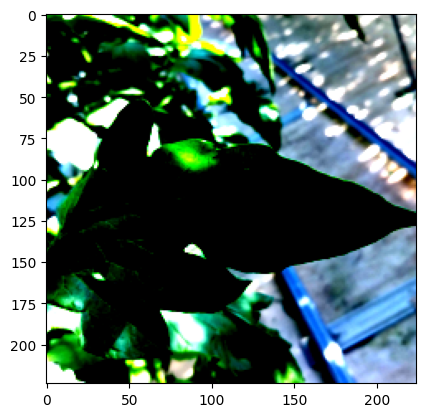

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: healthy


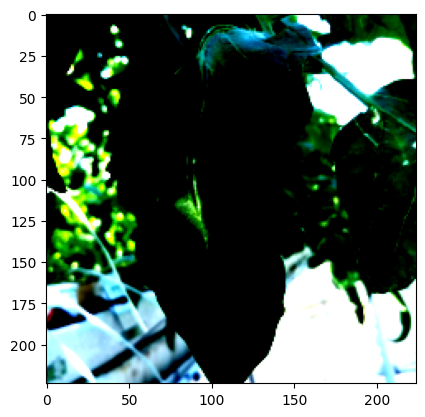

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


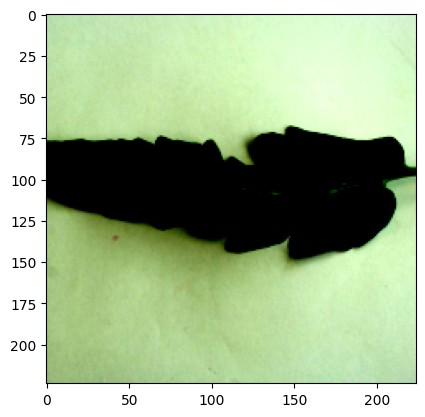

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


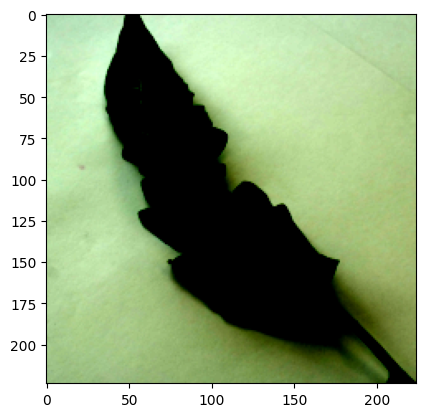

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


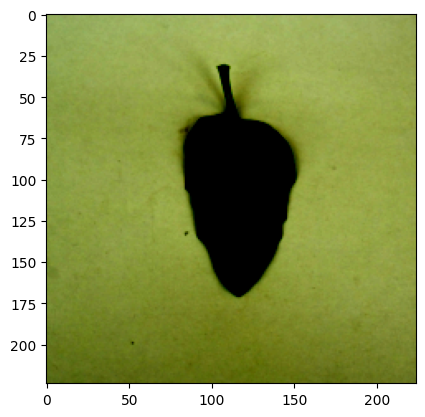

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


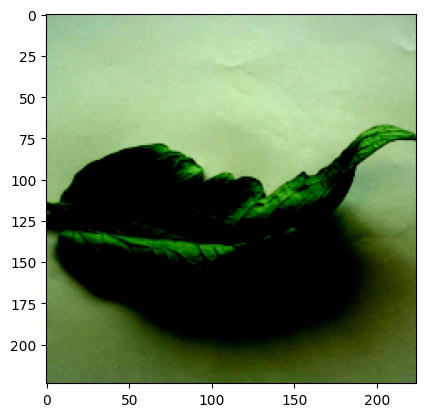

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: EarlyBlight


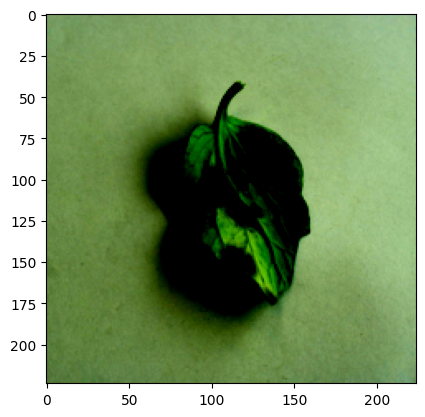

Wrong Prediction: YellowLeafCurlVirus


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


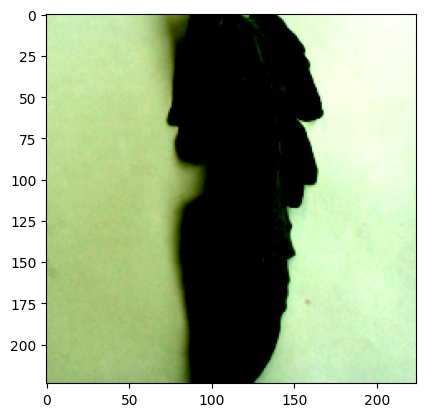

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


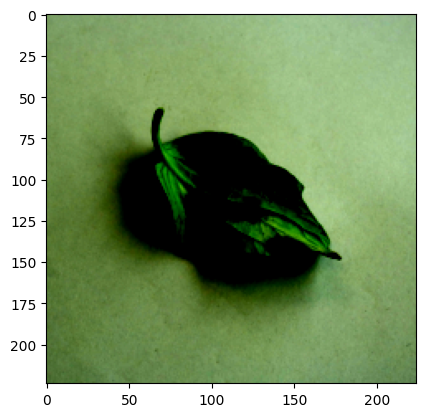

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


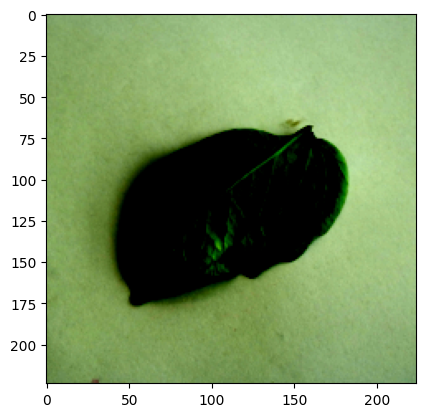

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


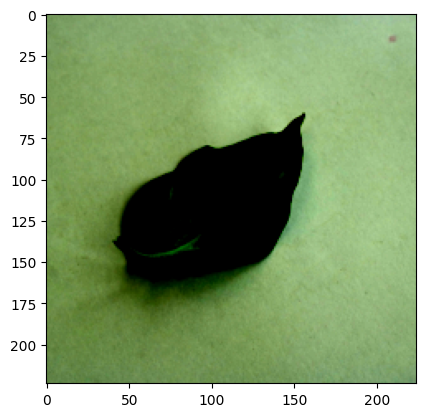

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: YellowLeafCurlVirus


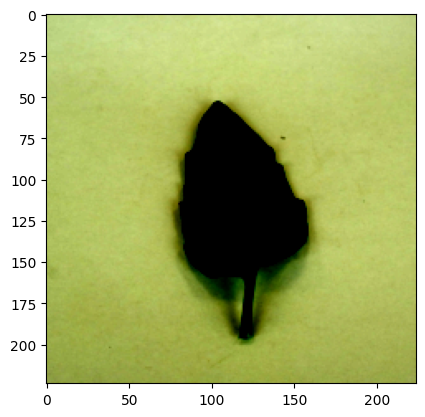

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Wrong Prediction: healthy


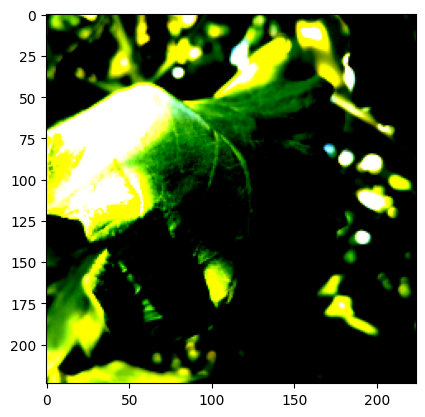

In [13]:
LeafMold_class_index = test_dataset.datasets[0].classes.index('LeafMold')

# LeafMold에 대한 틀린 예측 찾기
LeafMold_wrong_indices = [i for i, label in enumerate(wrong_labels) if label == LeafMold_class_index]

# LeafMold에 대한 틀린 예측과 이미지 출력
for i in LeafMold_wrong_indices:
    print(f'Wrong Prediction: {test_dataset.datasets[0].classes[wrong_predictions[i]]}')
    plt.imshow(np.transpose(wrong_images[i], (1, 2, 0)))  # C x H x W -> H x W x C
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 1
Wrong Prediction: EarlyBlight


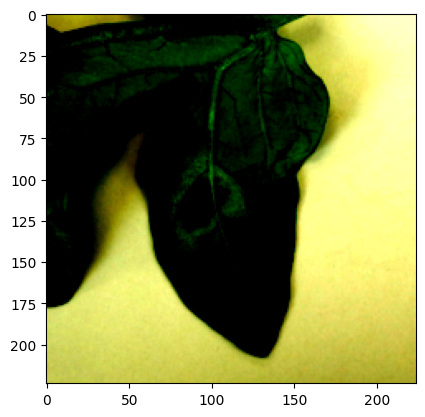

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: _
Wrong Prediction: YellowLeafCurlVirus


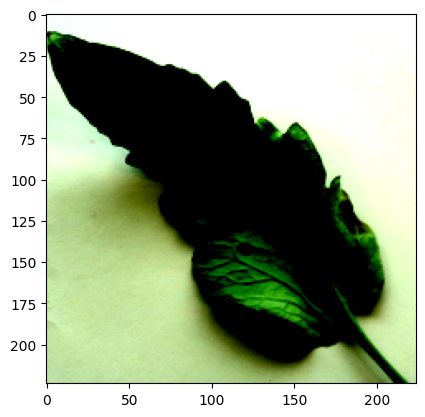

Image Path: 0
Wrong Prediction: EarlyBlight


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


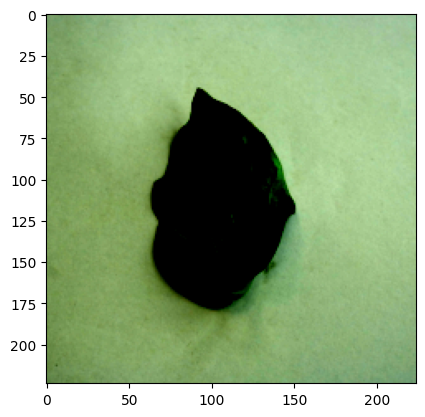

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 3
Wrong Prediction: YellowLeafCurlVirus


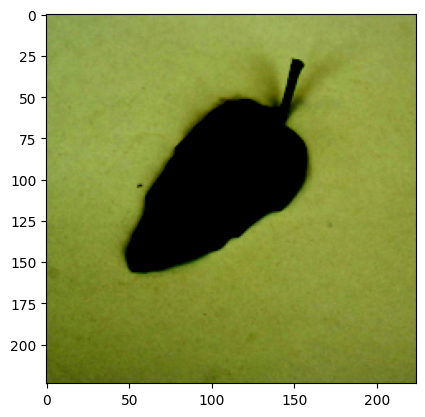

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: _
Wrong Prediction: YellowLeafCurlVirus


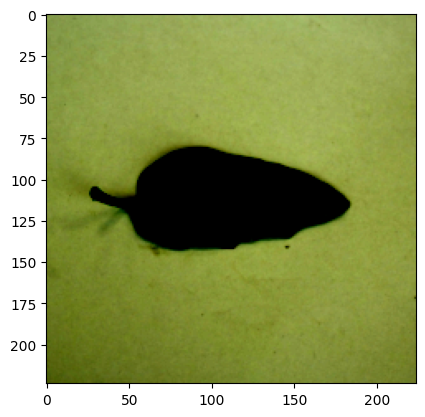

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 1
Wrong Prediction: YellowLeafCurlVirus


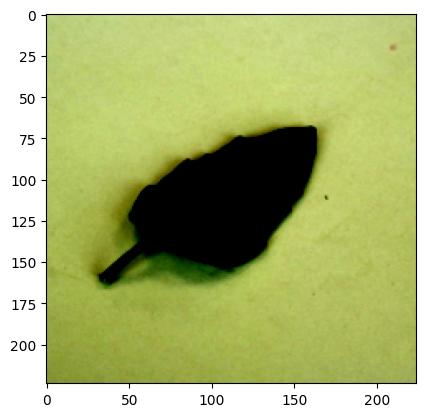

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 3
Wrong Prediction: healthy


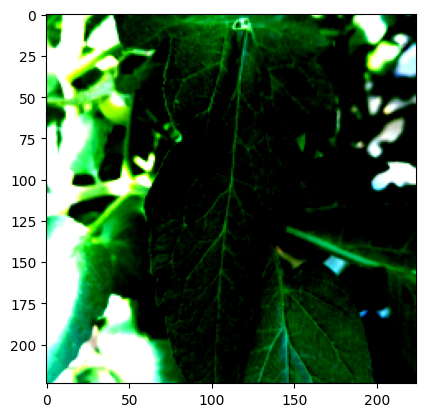

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: _
Wrong Prediction: YellowLeafCurlVirus


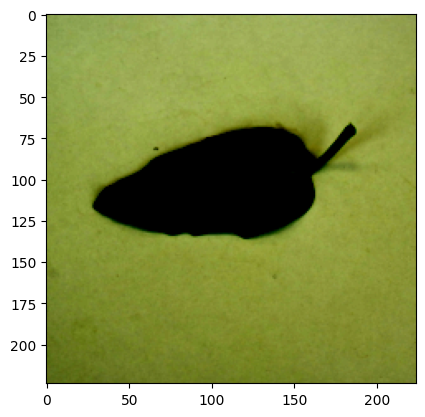

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 0
Wrong Prediction: YellowLeafCurlVirus


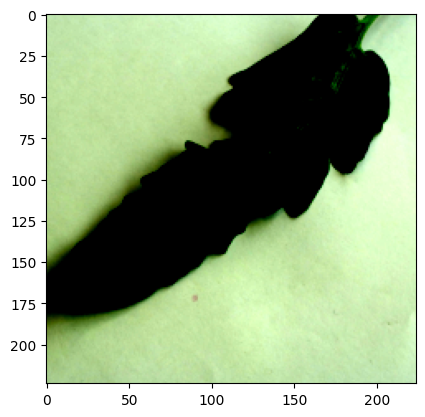

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: _
Wrong Prediction: healthy


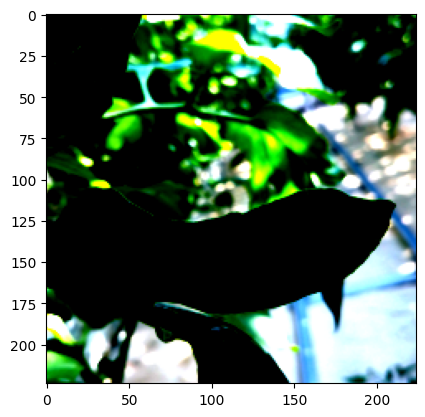

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: c
Wrong Prediction: YellowLeafCurlVirus


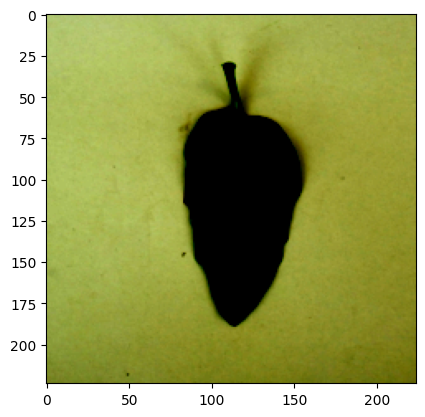

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 0
Wrong Prediction: YellowLeafCurlVirus


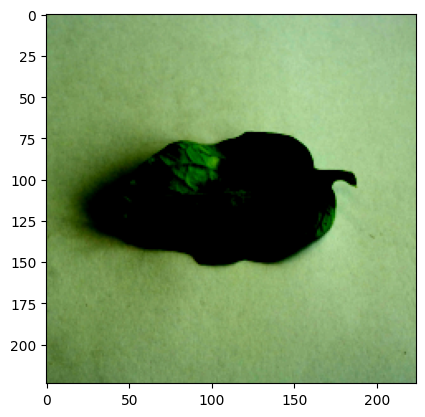

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 9
Wrong Prediction: YellowLeafCurlVirus


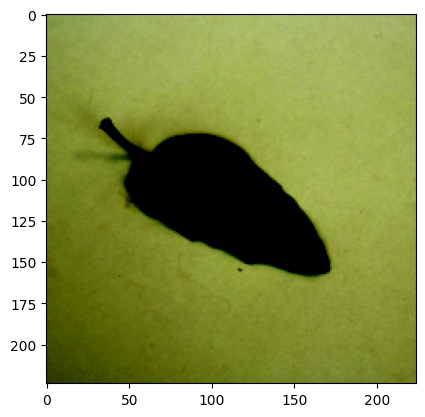

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: _
Wrong Prediction: YellowLeafCurlVirus


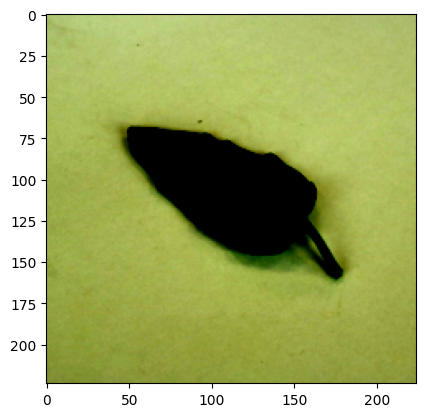

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 2
Wrong Prediction: YellowLeafCurlVirus


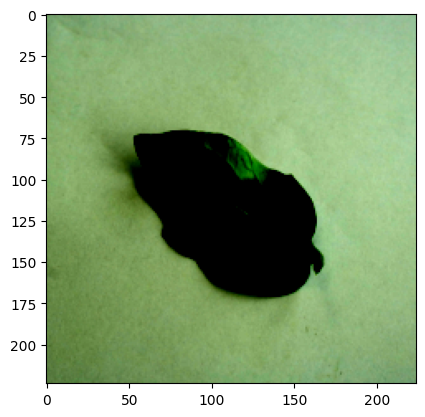

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 0
Wrong Prediction: YellowLeafCurlVirus


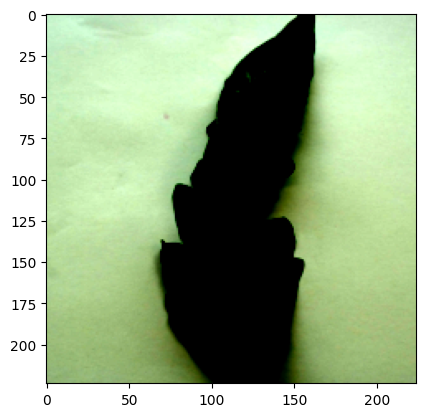

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 2
Wrong Prediction: YellowLeafCurlVirus


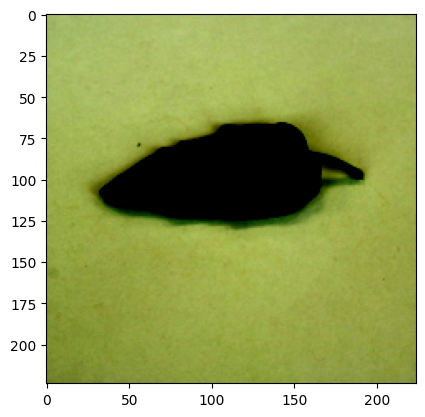

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 0
Wrong Prediction: YellowLeafCurlVirus


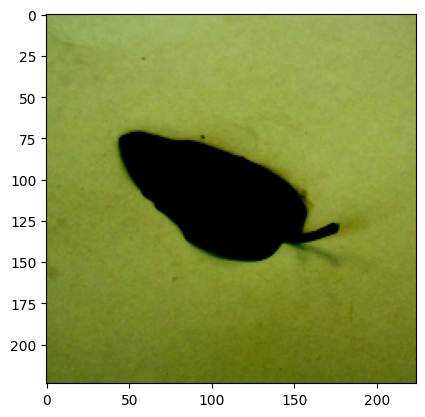

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 1
Wrong Prediction: YellowLeafCurlVirus


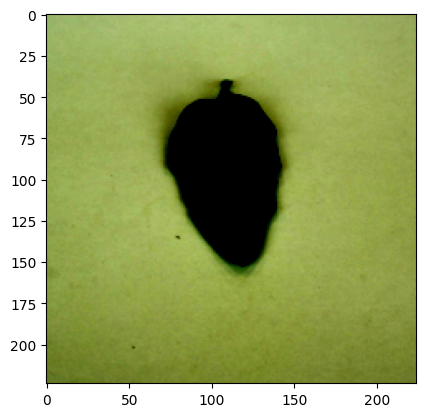

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 2
Wrong Prediction: YellowLeafCurlVirus


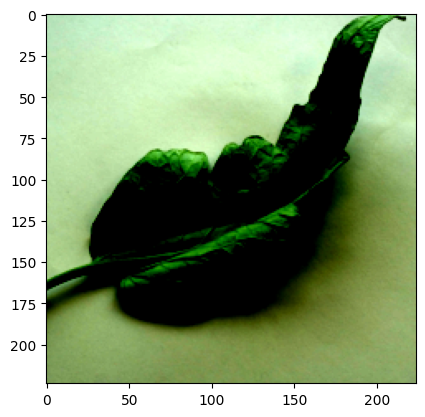

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 2
Wrong Prediction: EarlyBlight


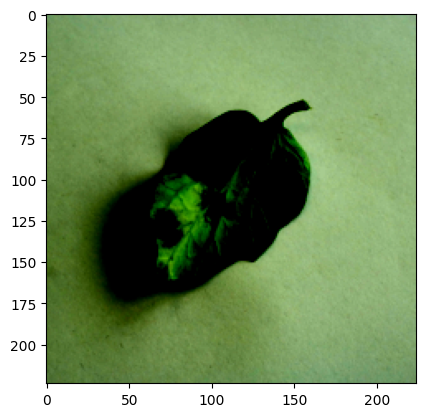

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 2
Wrong Prediction: YellowLeafCurlVirus


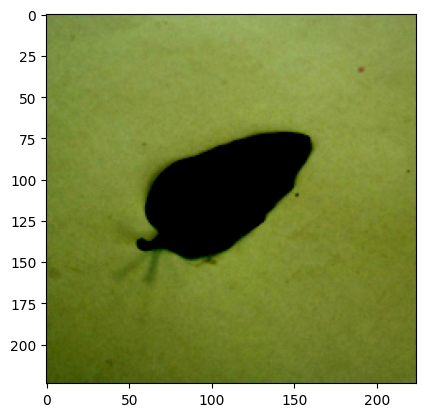

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: _
Wrong Prediction: healthy


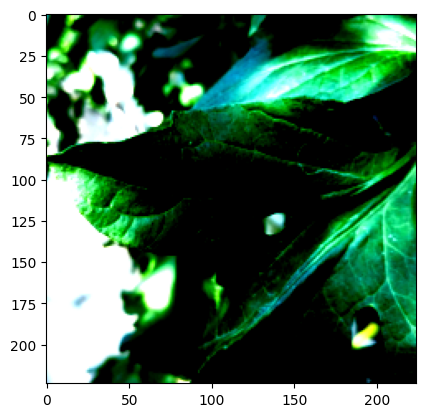

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 0
Wrong Prediction: healthy


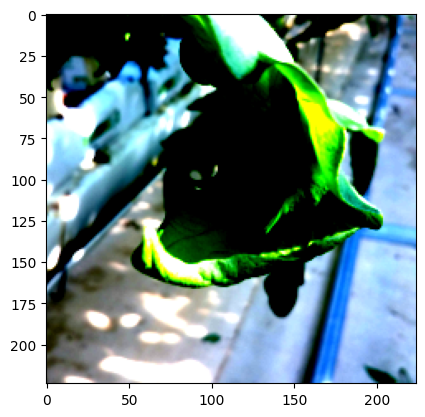

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 0
Wrong Prediction: YellowLeafCurlVirus


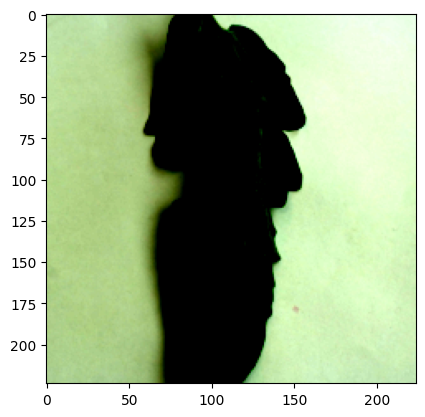

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 5
Wrong Prediction: YellowLeafCurlVirus


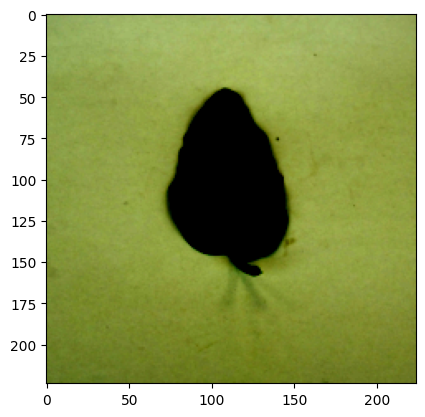

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 9
Wrong Prediction: YellowLeafCurlVirus


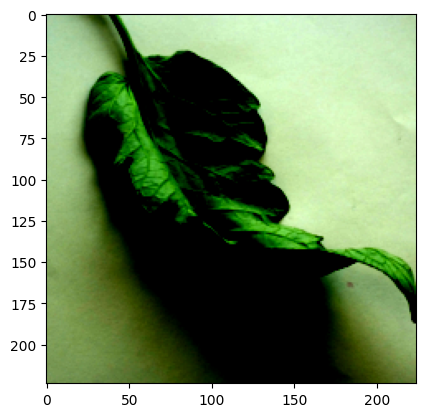

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: _
Wrong Prediction: YellowLeafCurlVirus


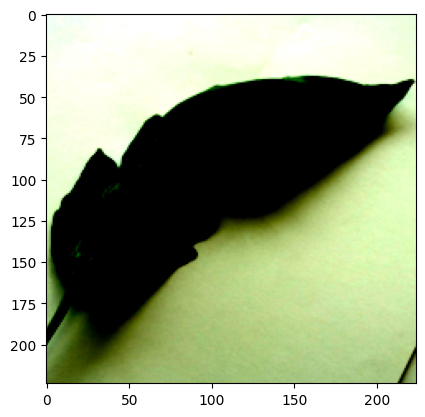

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: S
Wrong Prediction: healthy


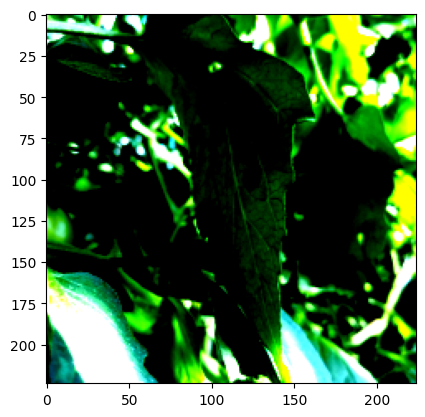

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 0
Wrong Prediction: YellowLeafCurlVirus


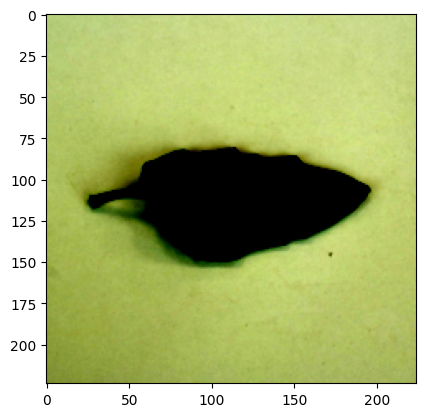

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 1
Wrong Prediction: YellowLeafCurlVirus


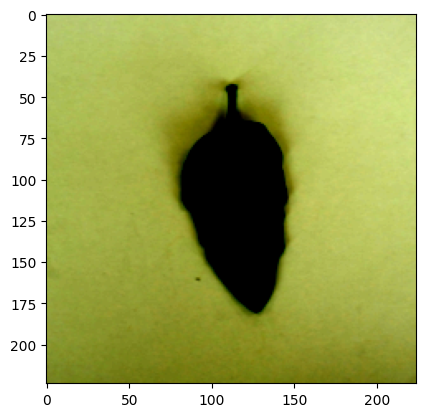

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: _
Wrong Prediction: YellowLeafCurlVirus


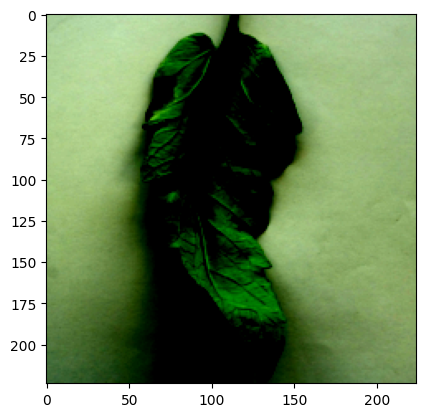

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 1
Wrong Prediction: YellowLeafCurlVirus


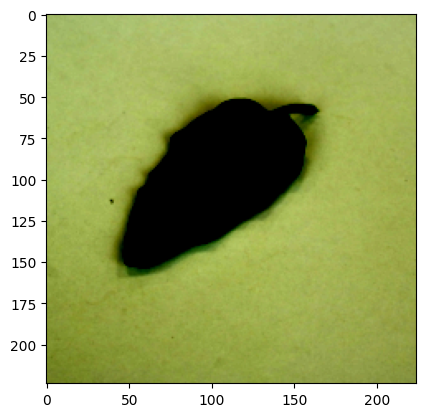

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: .
Wrong Prediction: YellowLeafCurlVirus


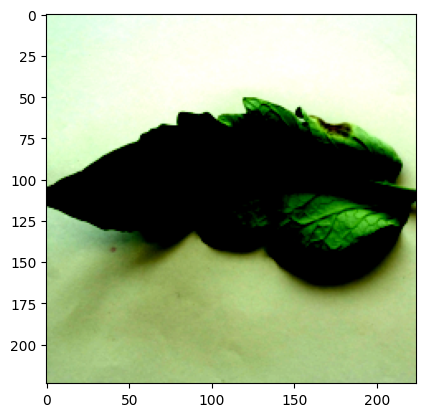

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: j
Wrong Prediction: YellowLeafCurlVirus


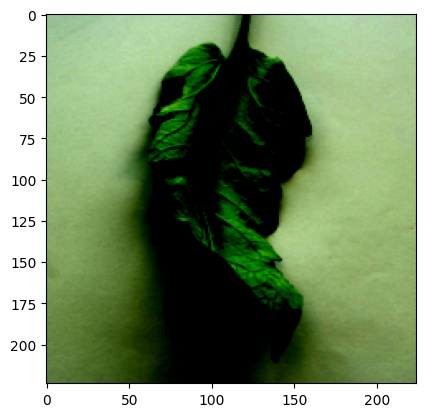

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: p
Wrong Prediction: YellowLeafCurlVirus


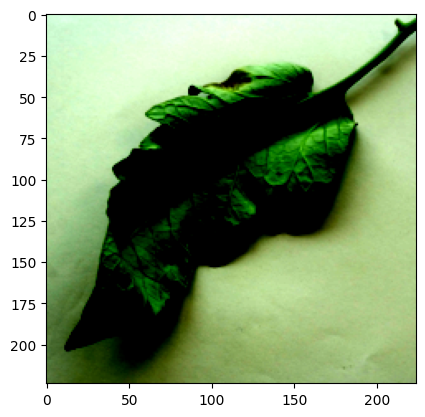

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: g
Wrong Prediction: healthy


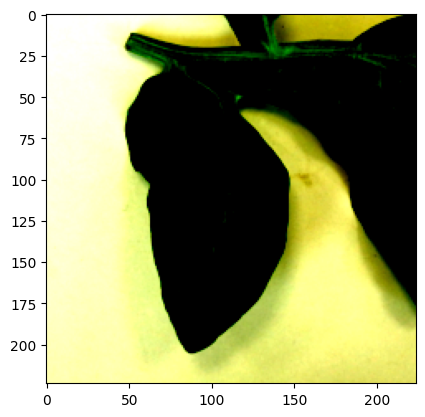

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: ./1_PowderyMildew/0005462_SAM_0993.png
Wrong Prediction: YellowLeafCurlVirus


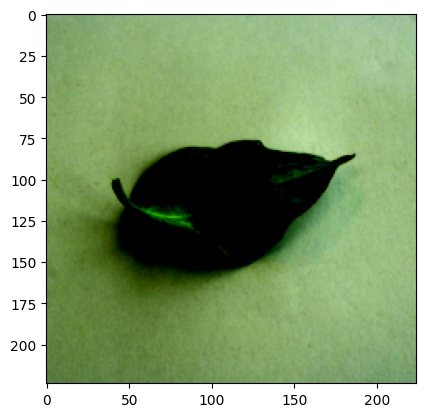

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: ./1_PowderyMildew/0017175_SAM_2524.png
Wrong Prediction: YellowLeafCurlVirus


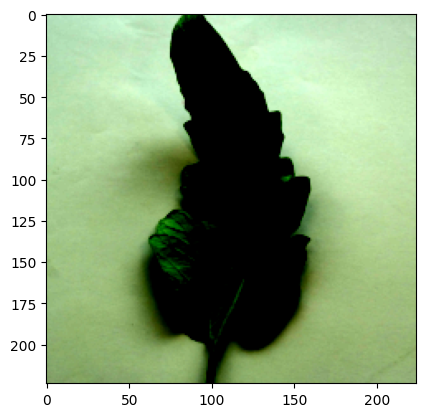

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: .
Wrong Prediction: healthy


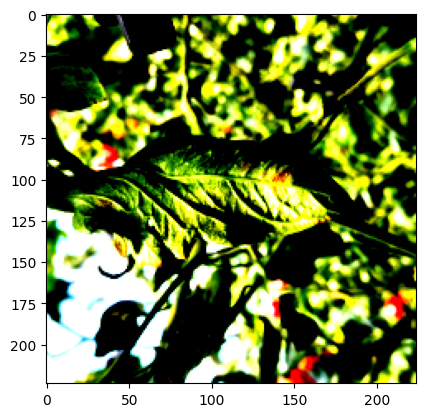

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: /
Wrong Prediction: YellowLeafCurlVirus


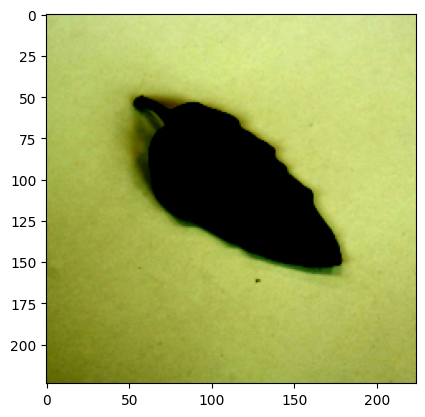

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: 1
Wrong Prediction: healthy


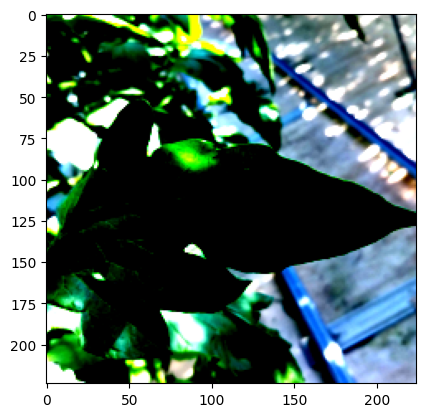

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: _
Wrong Prediction: healthy


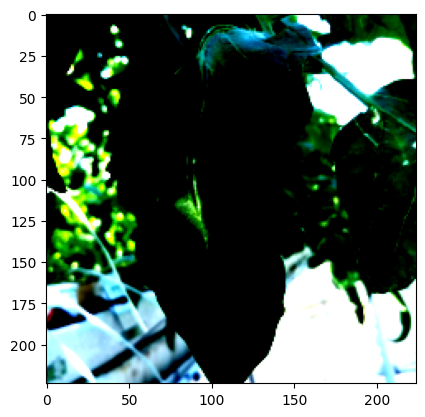

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: P
Wrong Prediction: YellowLeafCurlVirus


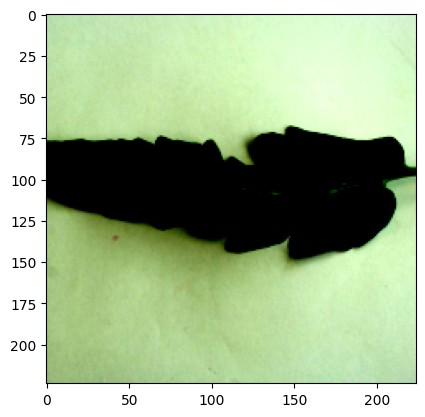

Image Path: o
Wrong Prediction: YellowLeafCurlVirus


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


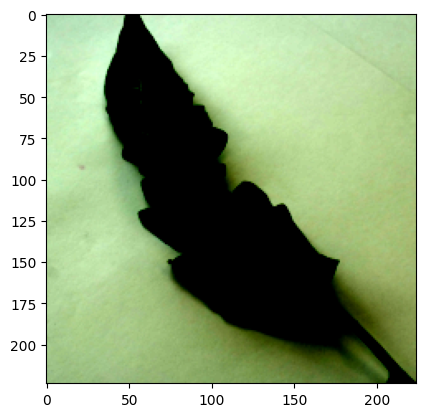

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: w
Wrong Prediction: YellowLeafCurlVirus


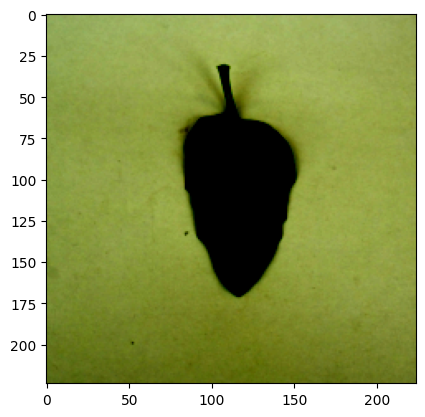

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: d
Wrong Prediction: YellowLeafCurlVirus


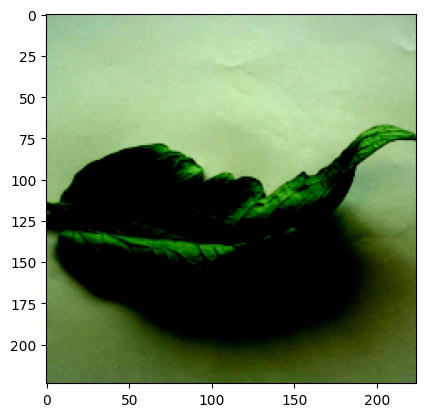

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: e
Wrong Prediction: EarlyBlight


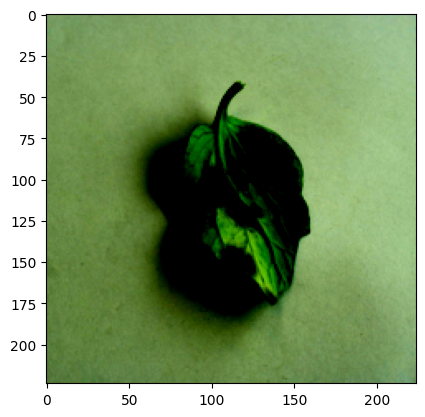

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: r
Wrong Prediction: YellowLeafCurlVirus


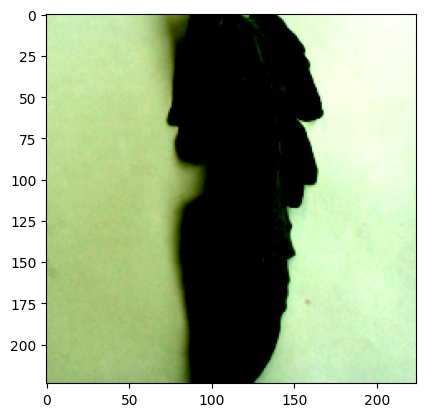

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: y
Wrong Prediction: YellowLeafCurlVirus


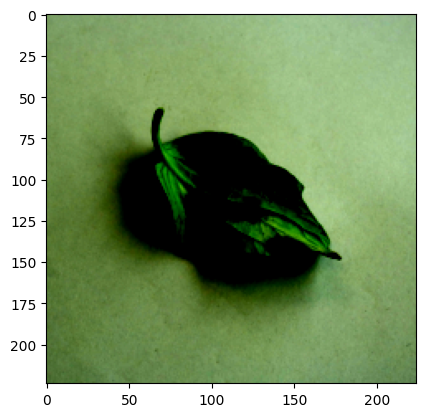

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: M
Wrong Prediction: YellowLeafCurlVirus


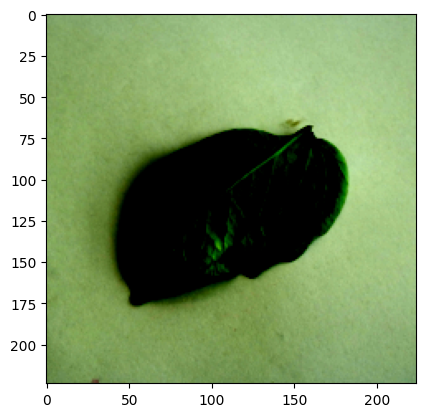

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: i
Wrong Prediction: YellowLeafCurlVirus


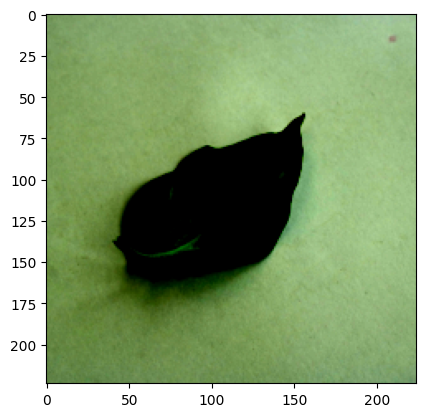

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: l
Wrong Prediction: YellowLeafCurlVirus


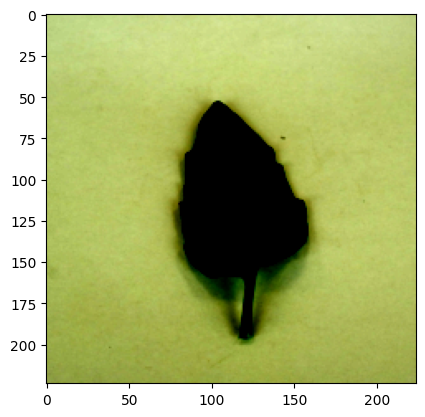

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Image Path: d
Wrong Prediction: healthy


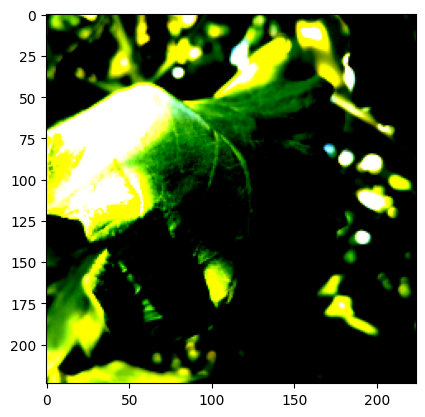

In [14]:
LeafMold_class_index = test_dataset.datasets[0].classes.index('LeafMold')

# LeafMold에 대한 틀린 예측 찾기
LeafMold_wrong_indices = [i for i, label in enumerate(wrong_labels) if label == LeafMold_class_index]

# LeafMold에 대한 틀린 예측과 이미지 출력
for i, index in enumerate(LeafMold_wrong_indices):
    print(f'Image Path: {wrong_image_paths[index]}')  # 이미지 경로 출력
    print(f'Wrong Prediction: {test_dataset.datasets[0].classes[wrong_predictions[index]]}')
    plt.imshow(np.transpose(wrong_images[index], (1, 2, 0)))
    plt.show()

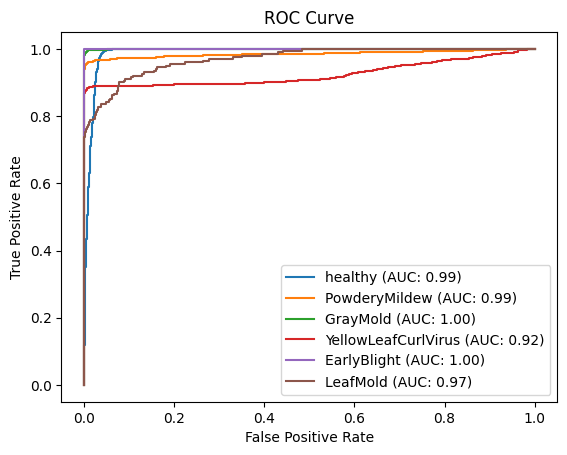

In [15]:
# ROC 커브 및 AUC 계산 (멀티 클래스의 경우 One-vs-Rest 방식 사용)
n_classes = len(test_dataset.datasets[0].classes)
fpr = dict()
tpr = dict()
roc_auc = dict()

all_labels_onehot = np.eye(n_classes)[all_labels]
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(all_labels_onehot[:, i], np.array(all_outputs)[:, i])
    roc_auc[i] = roc_auc_score(all_labels_onehot[:, i], np.array(all_outputs)[:, i])


# 모든 클래스에 대한 ROC 커브 플로팅
for i in range(n_classes):
    class_name = test_dataset.datasets[0].classes[i]
    plt.plot(fpr[i], tpr[i], label=f'{class_name} (AUC: {roc_auc[i]:.2f})')

plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.show()

In [ ]:
# Micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(all_labels_onehot.ravel(), np.array(all_outputs).ravel())
roc_auc["micro"] = roc_auc_score(all_labels_onehot, np.array(all_outputs), average="micro")

# Plot the micro-averaged ROC curve
plt.figure(figsize=(10, 8))
plt.plot(fpr["micro"], tpr["micro"],
         label=f'Micro-average ROC curve (AUC: {roc_auc["micro"]:.2f})')

# Plot details
plt.title('Micro-Averaged ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.show()
